# Plant Pathology 2020 FGVC 7

# Data Procurement and Readying

## Procurement

In [1]:
"""
Cell for getting data into google Colab
Uncomment and run
""";
from google.colab import files, drive
files.upload() # select the kaggle.json file from ~/.kaggle
!mkdir ~/.kaggle
!mv ./kaggle.json ~/.kaggle
!chmod 400 ~/.kaggle/kaggle.json # read permission for user
!ls ~/.kaggle

"""
Mounting gdrive to save the model
"""

drive.mount('/content/drive')

Saving kaggle.json to kaggle.json
kaggle.json
Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
import kaggle
kaggle.api.authenticate()

In [3]:
import zipfile
from pathlib import Path

# Download the files
competition = "plant-pathology-2020-fgvc7"
root = Path("./data")
kaggle.api.competition_download_files(competition,root,quiet=False,)

# Unzip the files
file = root/"plant-pathology-2020-fgvc7.zip"
z = zipfile.ZipFile(file,'r')
z.extractall(root)
z.close()

  0%|          | 0.00/779M [00:00<?, ?B/s]

100%|██████████| 779M/779M [00:14<00:00, 57.3MB/s]


## Readying

In [0]:
import torch
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import Dataset, DataLoader, Subset

from sklearn.model_selection import train_test_split

### File names as per dataset

In [5]:
"""
Create a list of filenames as per dataset
so that lazy loading can be done as and when
the data is required.
"""

np.random.seed(18)

train_csv_ = pd.read_csv(root/"train.csv")
class_names = train_csv_.columns[1:].to_list()
num_classes = len(class_names)
train_csv = train_csv_.to_numpy()
targets_ = train_csv[:,1:].argmax(axis=1)
train_all_fnames = train_csv[:,0]

# Creating the indices for names.
test_fnames = pd.read_csv(root/"test.csv").to_numpy().reshape(-1)
train_idx, valid_idx= train_test_split(np.arange(train_all_fnames.shape[0]), train_size=0.8, stratify=targets_)

# File names for the images.
train_fnames = train_all_fnames[train_idx]
valid_fnames = train_all_fnames[valid_idx]

# Targets for the images.
train_targets = targets_[train_idx]
valid_targets = targets_[valid_idx]

sets = ['train','valid','test']
TR, VA, TE = sets

targets = {TR: train_targets, VA:valid_targets}
fnames = {s:fn for s,fn in zip(sets,[train_fnames, valid_fnames, test_fnames])}

for s in fnames:
    print(s.ljust(5),fnames[s].shape)

train (1456,)
valid (365,)
test  (1821,)


In [6]:
# Get fnames by class for training
print(TR.ljust(6),end=" :: ")
fname_by_class_train = {c: fnames[TR][train_targets==i] for i,c in enumerate(class_names)}
for i in fname_by_class_train:print(f"{i} {len(fname_by_class_train[i]):3}  ",end="")
print()

# Get fnames by class for test
print(VA.ljust(6),end=" :: ")
fname_by_class_valid = {c: fnames[VA][valid_targets==i] for i,c in enumerate(class_names)}
for i in fname_by_class_valid:print(f"{i} {len(fname_by_class_valid[i]):3}  ",end="")
print()

# Get fnames by class for all (training)
print("all".ljust(6),end=" :: ")
fname_by_class_all = {c: train_all_fnames[targets_==i] for i,c in enumerate(class_names)}
for i in fname_by_class_all:print(f"{i} {len(fname_by_class_all[i]):3}  ",end="")

train  :: healthy 413  multiple_diseases  73  rust 497  scab 473  
valid  :: healthy 103  multiple_diseases  18  rust 125  scab 119  
all    :: healthy 516  multiple_diseases  91  rust 622  scab 592  

In [7]:
"""
Checking the validation and training ratios
and getting loss function weights.
"""
def count(s):
    temp = np.zeros((len(fnames[s]),4))
    temp[np.arange(len(fnames[s])),targets[s]] = 1
    temp = temp.sum(axis=0)
    return (temp.max()/temp)


weights = count('train')


print(weights)
print(count('valid'))

[1.20338983 6.80821918 1.         1.05073996]
[1.21359223 6.94444444 1.         1.05042017]


In [0]:
def if_not_mk(p):
    if not p.exists():
        p.mkdir(parents=True)

def move_train(path, fname_by_class):
    for cls in fname_by_class:
        if_not_mk(path/cls)
        for fn in fname_by_class[cls]:
            src = root/"images"/(fn+".jpg")
            dst = path/cls/(fn+".jpg")
            shutil.move(src, dst)

def move_test():
    # Moves test data to a nested folder to 
    # play better with ImageFolder
    loc = root/"test"/"unknown"
    if_not_mk(loc)
    for fn in fnames[TE]:
        src = root/"images"/(fn+".jpg")
        dst = loc/(fn+".jpg")
        shutil.move(src, dst)

def stop(): raise Exception("stop here")

train_path = root/"train"
valid_path = root/"valid"
test_path = root/"test"

move_test()
move_train(train_path, fname_by_class_train) 
move_train(valid_path, fname_by_class_valid) 

g_path = Path("/content/drive/My Drive/Colab Notebooks/k_PlantPathologyFGVC7")
g_state_path = g_path/"fitloop_state"
if_not_mk(g_state_path)

!rmdir /content/data/images

## Looking at the data and selecting the set of augmentation transforms.

In [9]:
!pip install albumentations

import torchvision
import albumentations as alb
import albumentations.pytorch as albpt
import matplotlib.pyplot as plt

from torch.utils.data import Dataset
from torchvision.datasets import ImageFolder
from torchvision import transforms
from tqdm.autonotebook import tqdm


     |████████████████████████████████| 634kB 6.3MB/s 
  Created wheel for imgaug: filename=imgaug-0.2.6-cp36-none-any.whl size=654020 sha256=053ba8d6da91deafecb8030c0e7118b463654f85e33826c5360fe168c9451237
  Stored in directory: /root/.cache/pip/wheels/97/ec/48/0d25896c417b715af6236dbcef8f0bed136a1a5e52972fc6d0
Successfully built imgaug
  Found existing installation: imgaug 0.2.9
    Uninstalling imgaug-0.2.9:
      Successfully uninstalled imgaug-0.2.9


#### Create Custom Dataset 

In [0]:
"""
ImageFolder derivative Datasets
"""
rsz = transforms.Resize((600,900))

class LeafDS(ImageFolder):
    # Uses albumentation transforms for training
    def __init__(self, root, transform, use_albumentations=True,*args,**kwargs):
        super().__init__(root, *args, **kwargs)
        self.use_albumentations = use_albumentations
        self._transf = transform
        self._preload = False
        self._tfmload = False

    def __getitem__(self, idx):
        if self._tfmload:
            return self._tfmi[idx]

        if self._preload:
            x, y =  self._imgs[idx]
        else:
            x, y = super().__getitem__(idx)

        if self.use_albumentations:
            x = np.array(x)
            x = self._transf(image=x)["image"]
        else:
            x = self._transf(x)
        return x, y

    def image(self, idx):
        if self._preload:
            x, y =  self._imgs[idx]
        else:
            x, y = super().__getitem__(idx)
        return x, y
    
    def tfmload(self):
        assert self._preload is True
        _tfmi = []
        for x,y in tqdm(self._imgs):
            if self.use_albumentations:
                x = np.array(x)
                x = self._transf(image=x)["image"]
            else:
                x = self._transf(x)
            _tfmi.append((x,y))
        self._tfmi = _tfmi
        self._tfmload = True
    
    def preload(self):
        _imgs = []
        for idx in tqdm(range(len(self))):
            x,y = super().__getitem__(idx)
            _imgs.append((rsz(x),y))
        self._imgs = _imgs
        self._preload = True
    
    def __len__(self):
        if self._preload:
            return len(self._imgs)
        else:
            return super().__len__()

class TestDS(Dataset):
    get_fname = lambda _, path: path.parts[3].split(".")[0]
    def __init__(self, root, transforms):
        self._tsfm = transforms
        self._paths = [*root.iterdir()]
        self.targets = list(map(self.get_fname, self._paths))

    def __getitem__(self, idx):
        path = self._paths[idx]
        fnam = self.get_fname(path)
        x = self._tsfm(Image.open(path))
        return x, fnam
    
    def image(self, idx):
        path = self._paths[idx]
        return rsz(Image.open(path)), self.get_fname(path)

    def __len__(self):
        return len(self._paths)
    

def hard_sample_swap(trainer, indices):

    assert trainer.train_dl.dataset._preload is True
    assert trainer.valid_dl.dataset._preload is True
    assert len(trainer.valid_dl.dataset) >= len(indices)

    for idx in indices:
        to_valid = trainer.train_dl.dataset.image(idx)
        to_train = trainer.valid_dl.dataset.image(idx)
        trainer.train_dl.dataset._imgs[idx] = to_train
        trainer.valid_dl.dataset._imgs[idx] = to_valid

    try:
        trainer.valid_dl.dataset._tfmi.clear()
        trainer.train_dl.dataset._tfmi.clear()
    except:
        pass
    trainer.valid_dl.dataset._tfmload = False
    trainer.train_dl.dataset._tfmload = False

    # trainer.valid_dl.dataset.tfmload()
    # trainer.train_dl.dataset.tfmload()

#### Helpers

In [0]:
mean=np.array([0.4045, 0.5128, 0.3137])
std=np.array([0.1916, 0.1758, 0.1733])

# def manual_preload(ds, is_train=False):
#     _imgs = []
#     for sample in tqdm(ds): _imgs.append(sample)
#     ds.preload = True
#     ds._imgs = _imgs

"""
Use albumentations for train time augmentations
Use torchvision transforms for test time augmentaitons cause
10 crop is not available with albumentations and that is required
while testing. The use of torchvision shouldn't matter much cause
the only transforms that will be applied are normalization, crops
"""

def untensor(img):
    img = img.detach().cpu().squeeze().numpy()
    img *= std.reshape(3,1,1)
    img += mean.reshape(3,1,1)
    img *= 255
    return np.uint8(img).transpose(1,2,0)

def splot(img,r=1,c=1,i=1):
    # To show normalized tensor images
    plt.subplot(r,c,i)
    try:
        plt.imshow(img)
    except:
        plt.imshow(untensor(img))
    plt.axis('off')

def show_data(ds, per_class=24, c=4, transform=False):
    r = int(per_class * 4 /c)

    indices = {cn:np.where(np.array(ds.targets)==i)[0] for i,cn in enumerate(class_names)}
    indices = {cn: np.random.permutation(indices[cn])[:per_class]  for cn in indices}

    plt.figure(figsize=(24,r*4))
    i = 1
    bar = tqdm(total = c*r)
    for key in indices:
        for idx in indices[key]:
            if transform:
                x, y = ds[idx]
            else:
                x, y = ds[idx]
                x = np.array(x)
            splot(x, r, c, i); i += 1
            plt.title(f"{class_names[y]}")
            bar.update(1)
    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()

In [0]:
stop() # Don't run the next cell, takes time make hang.

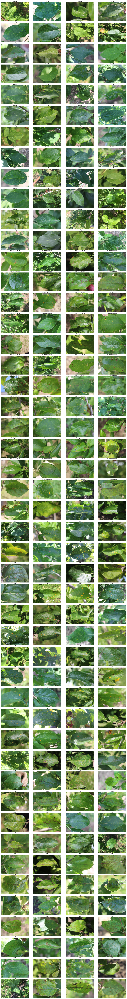

In [0]:
ds = LeafDS(train_path, alb.Resize(683,1024))
show_data(ds, 48)

In [12]:
"""
TRANSFORMS
"""
initial_size = (2048,1365)
width = int(initial_size[0]/2.5)
height = int(initial_size[1]/2.5)
scale = 0.6

print("resize: ".ljust(12),width, height)
print("center crop:".ljust(12),int(width*scale), int(height*scale))

"""
Train time transforms
"""

train_transf = alb.Compose([
                    alb.Resize(height=height, width=width),
                    alb.CenterCrop(height=int(height*scale),width=int(width*scale)),
                    # alb.CLAHE((0.5,0.5),p=1), # Maybe later, will need for TTA
                    alb.Blur((3,6),p=0.2),
                    alb.RandomBrightnessContrast((-0.3,0.1),(-0.1,0.1),p=0.1),
                    alb.RandomGamma((85,110),p=0.1),
                    alb.Flip(p=0.7),
                    alb.Rotate((-20,20),p=0.5),
                    alb.RandomCrop(310,310),
                    alb.Resize(256,256),
                    albpt.ToTensor(normalize={
                        "mean": mean,
                        "std":std
                    })
])

"""
Test time transforms
"""

aux = transforms.Compose([
    transforms.Resize(size=(256,256)),
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

scale = 0.65
test_transf = transforms.Compose([
                    transforms.Resize(size=(height,width)),
                    transforms.CenterCrop(size=(int(height*scale),int(width*scale))),
                    transforms.TenCrop(size=(310,310)),
                    transforms.Lambda(lambda crops: torch.stack([aux(crop) for crop in crops]))
])

resize:      819 546
center crop: 491 327


In [0]:
stop()

resize:      819 546
center crop: 491 327


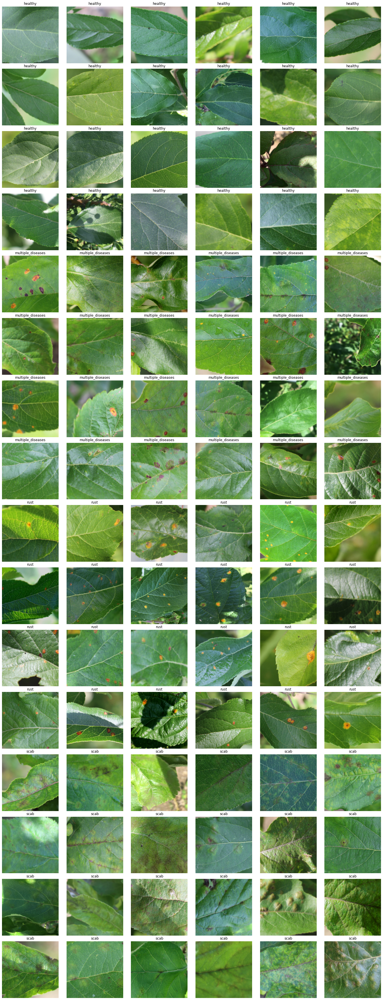

In [0]:
"""
DISPLAY THE TRANSFORMED IMAGES
"""
ds._transf = train_transf
show_data(ds, c=6, transform=True)

### Dataset & DataLoader

In [0]:
"""
DATASETS
"""

ds_train = LeafDS(train_path, train_transf)
ds_valid = LeafDS(valid_path, test_transf, use_albumentations=False)
ds_test = TestDS(test_path/"unknown", test_transf)

# For the meta dataset logit generation
# ds_train = LeafDS(train_path, test_transf, use_albumentations=False)
# ds_valid = LeafDS(valid_path, test_transf, use_albumentations=False)

In [0]:
ds_train.preload()
# ds_train.tfmload() # Transform values are stochastic, don't preload

ds_valid.preload()
# ds_valid.tfmload()

In [0]:
def append_to_train(ds_train=ds_train, ds_valid=ds_valid):
    assert ds_train._preload
    assert ds_valid._preload

    for i in range(len(ds_valid)):
        ds_train._imgs.append(ds_valid.image(i))
    print(len(ds_train),len(ds_valid))

# Trying something...
# append_to_train()

1821 365


In [0]:
"""
COLLATE FUNCTION ∵ TTA
"""
def collate_fn(x):
    # Get images and labels from the input
    ims = [im for im,_ in x]
    lbs = [lb for _,lb in x]
    # Concat images and repeat the labels
    ims = torch.cat(ims)
    lbs = torch.tensor(lbs).long()
    return ims, lbs
    

In [15]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
    print(torch.cuda.get_device_name())
    print(torch.cuda.get_device_properties(device))

batch_size_test = 16
batch_size_train = 16

if torch.cuda.is_available() and \
torch.cuda.get_device_properties(device).total_memory/2**30 > 15:
    batch_size_train = 32

num_workers = 2 if torch.cuda.is_available() else 0

dl_train = DataLoader(ds_train, batch_size_train, shuffle=True, num_workers=num_workers, pin_memory=True)
dl_valid = DataLoader(ds_valid, batch_size_test, shuffle=True, num_workers=num_workers, collate_fn=collate_fn, pin_memory=True)
# dl_test = DataLoader(ds_test, batch_size_test, shuffle=False, num_workers=num_workers, collate_fn=collate_fn, pin_memory=True)

Tesla K80
_CudaDeviceProperties(name='Tesla K80', major=3, minor=7, total_memory=11441MB, multi_processor_count=13)


In [0]:
"""
MICRO DATASET AND DATALOADER
"""

u_split = 0.08
_, u_idx = train_test_split(np.arange(len(ds_train.targets)),test_size = u_split, stratify=ds_train.targets)
ds_u = Subset(ds_train, u_idx)
dl_u = DataLoader(ds_u, batch_size_train, shuffle=True, num_workers=num_workers, pin_memory=True)

In [0]:
"""
INCASE A DIFFERENT BATCHISIZED TRAIN DL IS REQUIRED.
"""
def get_dl(batch_size=32,name='train'):
    dl = {
        'train': ds_train,
        'micro': ds_u
    }
    return DataLoader(dl[name], batch_size, shuffle=True, num_workers=num_workers, pin_memory=True)

In [0]:
stop()

In [0]:
print("Time to iterate over DataLoaders:")

print("\ntrain")
%time for _ in dl_train: continue

print("\nmicro")
%time for _ in dl_u: continue

print("\nvalid")
%time for _ in dl_valid: continue

# print("\ntemp")
# %time for _ in dl_test: continue

Time to iterate over DataLoaders:

train
CPU times: user 482 ms, sys: 531 ms, total: 1.01 s
Wall time: 14.3 s

micro
CPU times: user 42.2 ms, sys: 214 ms, total: 256 ms
Wall time: 1.48 s

valid
CPU times: user 905 ms, sys: 1.59 s, total: 2.49 s
Wall time: 16.1 s

temp
CPU times: user 4.47 s, sys: 3.51 s, total: 7.98 s
Wall time: 2min 36s


In [18]:
print(len(ds_u),len(ds_train),len(ds_valid),len(ds_test))
print(len(dl_u),len(dl_train),len(dl_valid))

117 1456 365 1821
8 91 23


# Model Setup

**TL Strategy**: Removing the last two layers (fc and AdaptiveAvgPool2d) and replacing it with [fastai](https://docs.fast.ai/layers.html#AdaptiveConcatPool2d)'s way of creating a conv learner by using an [AdaptiveConcatPool2d](https://docs.fast.ai/layers.html#AdaptiveConcatPool2d) followed by a Flatten, blocks of Batchnorm, Dropout, Linear, ReLU.

- EfficientNet B4
- Densenet 201
- ResNet 101
- ResNext 50
- ResNet 50

In [19]:
!pip install fitloop
!pip install efficientnet_pytorch

import torch.nn as nn
import torch.nn.functional as F

from efficientnet_pytorch import EfficientNet
from torchvision.models import densenet201, resnet101, resnext50_32x4d, resnet50
from fitloop.helpers.utils import freeze, unfreeze

  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.6.3-cp36-none-any.whl size=12422 sha256=ac977d730af1a771b4ae343dc472b0bb4c91d3bba80b9cf346e8dd98c9fb70a0
  Stored in directory: /root/.cache/pip/wheels/42/1e/a9/2a578ba9ad04e776e80bf0f70d8a7f4c29ec0718b92d8f6ccd
Successfully built efficientnet-pytorch


In [0]:
"""
DEFINING THE HEAD USED BY ALL MODELS
"""

class AdaptiveConcat2d(nn.Module):
    def __init__(self, output_size=(1,1)):
        super().__init__()
        self.adaptive_avg_2d = nn.AdaptiveAvgPool2d(output_size)
        self.adaptive_max_2d = nn.AdaptiveMaxPool2d(output_size)
    
    def forward(self,X):
        return torch.cat([
            self.adaptive_avg_2d(X),
            self.adaptive_max_2d(X),
        ],1)

class EndBlocks(nn.Module):
    def __init__(self, in_features, out_features, momentum=0.1, p=0.5, is_relu=True):
        super().__init__()
        self.bn = nn.BatchNorm1d(in_features, momentum=momentum)
        self.do = nn.Dropout(p)
        self.li = nn.Linear(in_features, out_features)
        self.is_relu = is_relu
    
    def forward(self, x):
        x = self.bn(x)
        x = self.do(x)
        x = self.li(x)
        if self.is_relu:
            return F.relu(x)
        else:
            return x
        
class Head(nn.Module):
    def __init__(self, in_features=2048, out_features=num_classes, concat=True):
        super().__init__()
        self.concat = concat
        if concat:
            self.aac = AdaptiveConcat2d()
        self.eb1 = EndBlocks(in_features*2, 512, p=0.5)
        self.eb2 = EndBlocks(512, out_features, p=0.75, momentum=0.01, is_relu=False)
        
    def forward(self, x):
        if self.concat:
            x = self.aac(x)
        x = x.view(x.size(0),-1)
        x = self.eb1(x)
        x = self.eb2(x)
        return x

In [0]:
"""
SPLICING HEAD AND BACKBONE TOGETHER
"""

def get_backbone(name, pretrained):
    models = {
        "dn201":lambda: densenet201(pretrained),                   # 20.0M
        "rn101":lambda: resnet101(pretrained),                     # 44.5M
        "rnx50":lambda: resnext50_32x4d(pretrained),               # 88.7M
        "rne50":lambda: resnet50(pretrained),             
        "effn4":lambda: EfficientNet.from_pretrained("efficientnet-b4")\
                if pretrained else \
                lambda: EfficientNet.from_name("efficientnet-b4")  # 19. M
    }
    if name == "effn4" and not pretrained:
        return models[name]()()
    return models[name]()

def build_model(name, pretrained=False):
    backbone_ = get_backbone(name, pretrained)
    bb_slice = {
        "dn201":slice(-1),
        "rn101":slice(-2),
        "rnx50":slice(-2),
        "rne50":slice(-2),
        "effn4":slice(-4)
    }
    in_features = {
        "dn201":1920, # 455 ms
        "rn101":2048, # 400 ms
        "rnx50":2048, # 
        "rne50":2048, # 
        "effn4":2560  # 
    }
    if name == "effn4":
        # The 'Head' defined above doesn't
        # seem to work with efficient nets
        # gradients don't flow.
        model = backbone_
        model._fc = nn.Linear(1792, 4)
        freeze(model)
        unfreeze(model._fc)
    else:
        backbone = nn.Sequential(*[*backbone_.children()][bb_slice[name]])
        head = Head(in_features[name])
        model = nn.Sequential(backbone, head)
        freeze(model[0])
        unfreeze(model[1])
    return model

model_names = ["dn201","rn101","rnx50","rne50","effn4"]

In [0]:
stop() 

## Figuring out batchsize

In [0]:
# Test to see if batch fits in memory.
def fp_bp_test(model, dl=dl_u, is_train=True):
    optim = torch.optim.Adam(model.parameters())
    lossf = nn.CrossEntropyLoss()
    if is_train:
        model.train().to(device)
    else:
        model.eval().to(device)

    for X,y in tqdm(dl):
        X = X.to(device)
        y = y.to(device)
        with torch.set_grad_enabled(is_train):
            y_ = model(X)
            if is_train:
                loss = lossf(y_, y)
                loss.backward()
                optim.step()
                accu = ((y_.argmax(dim=1)==y).sum()/float(y.size(0))).detach().cpu()
                rlos = loss.detach().cpu().item() * y.size(0)
                del loss

        del X, y, y_

In [0]:
!nvidia-smi

In [0]:
"""
Testing :: grad not required
"""
for name in model_names:
    print(name)
    fp_bp_test(build_model(name), dl=dl_valid, is_train=False)
    print(torch.cuda.memory_summary(abbreviated=True))
    print()

dn201



|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |       0 B  |    2197 MB |    1212 GB |    1212 GB |
|---------------------------------------------------------------------------|
| Active memory         |       0 B  |    2197 MB |    1212 GB |    1212 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |    3888 MB |    3888 MB |    3888 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |       0 B  |    2599 MB |    1990 GB |    1990 GB |
|---------------------------------------------------------------------------|
| Active memory         |       0 B  |    2599 MB |    1990 GB |    1990 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |    5078 MB |    5078 MB |    5078 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |       0 B  |    2599 MB |    2523 GB |    2523 GB |
|---------------------------------------------------------------------------|
| Active memory         |       0 B  |    2599 MB |    2523 GB |    2523 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |    5078 MB |    5078 MB |    5078 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |       0 B  |    2599 MB |    3047 GB |    3047 GB |
|---------------------------------------------------------------------------|
| Active memory         |       0 B  |    2599 MB |    3047 GB |    3047 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |    5078 MB |    5078 MB |    5078 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |       0 B  |    4754 MB |    4574 GB |    4574 GB |
|---------------------------------------------------------------------------|
| Active memory         |       0 B  |    4754 MB |    4574 GB |    4574 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |   10862 MB |   10862 MB |   10862 MB |       0 B  |
|--------------------------------------------------------------

In [0]:
"""
Training :: grad required
"""
for name in model_names:
    print(name)
    model = build_model(name)
    unfreeze(model)
    fp_bp_test(model, dl=get_dl(batch_size=32, name="micro"))
    print(torch.cuda.memory_summary(abbreviated=True))
    del model
    print()

dn201



|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |  157942 KB |    8462 MB |     925 GB |     925 GB |
|---------------------------------------------------------------------------|
| Active memory         |  157942 KB |    8462 MB |     925 GB |     925 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |   10326 MB |   10326 MB |   10326 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |  356957 KB |    8462 MB |     993 GB |     993 GB |
|---------------------------------------------------------------------------|
| Active memory         |  356957 KB |    8462 MB |     993 GB |     993 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |   10454 MB |   10454 MB |   10454 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |  197875 KB |    8462 MB |    1040 GB |    1040 GB |
|---------------------------------------------------------------------------|
| Active memory         |  197875 KB |    8462 MB |    1040 GB |    1040 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |   10966 MB |   10966 MB |   10966 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |  203743 KB |    8462 MB |    1082 GB |    1081 GB |
|---------------------------------------------------------------------------|
| Active memory         |  203743 KB |    8462 MB |    1082 GB |    1081 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |   10966 MB |   10966 MB |   10966 MB |       0 B  |
|--------------------------------------------------------------


|===========================================================================|
|                  PyTorch CUDA memory summary, device ID 0                 |
|---------------------------------------------------------------------------|
|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |
|===========================================================================|
|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |
|---------------------------------------------------------------------------|
| Allocated memory      |  159078 KB |    9710 MB |    1229 GB |    1229 GB |
|---------------------------------------------------------------------------|
| Active memory         |  159078 KB |    9710 MB |    1229 GB |    1229 GB |
|---------------------------------------------------------------------------|
| GPU reserved memory   |   14078 MB |   14078 MB |   14078 MB |       0 B  |
|--------------------------------------------------------------

In [0]:
print(torch.cuda.memory_summary(abbreviated=True))

# Pretrain Setup

In [0]:
import torch.optim as optim
import torch.optim.lr_scheduler as lr_scheduler

from fitloop import FitLoop
from fitloop.helpers.utils import get_layers, freeze, unfreeze, get_lrs

## Helper Functions

### Metrics

In [0]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score
"""
Functions to get a dict of useful scores
"""
def cls_score(y_, y, cls, score_function):
    y_ = y_ == cls
    y = y == cls
    return score_function(y, y_)

def get_scores(y_, y, all=False, cls=4):
    y = y.numpy()
    p = F.softmax(y_, dim=1).numpy()
    y_ = y_.argmax(dim=1).numpy()

    corr = (y_ == y).sum()
    accu = corr/len(y)
    try:
        rauc = roc_auc_score(y, p, average="macro", multi_class="ovr")
    except:
        rauc = -1.

    if all:
        re = []
        pr = []
        f1 = []
        for i in range(cls):
            r = cls_score(y_, y, i, recall_score)
            p = cls_score(y_, y, i, precision_score)
            f = 2/(1/r + 1/p)
            re.append(r)
            pr.append(p)
            f1.append(f)
        prf = {
            "precision":re,
            "recall":pr,
            "f1":f1,
        }
    else:
        prf = {}

    return {
        "corrects":corr,
        "accuracy":accu,
        "rocauc":rauc,
        **prf
    }
    
def clf_metrics(model, dl):
    model.to(device).eval()
    logits = []
    actual = []
    for x,y in tqdm(dl.dataset):
        if len(x.size()) != 4:
            x = x.unsqueeze(0)

        with torch.no_grad():
            y_ = model(x.to(device))
            if  y_.size(0) == 10:
                y_ = y_.mean(dim=0)

        actual.append(y)
        logits.append(y_.detach().cpu())

        del x, y, y_

    logits = torch.stack(logits, dim=0).squeeze()
    actual = torch.tensor(actual)
    scores = get_scores(logits, actual, all=True)
        
    return scores, logits, actual

### Inspection

In [0]:
def print_scores(scores):
    # Print the scores
    print(f"accuracy  :: {scores['accuracy']:0.4f}")
    print(f"roc-auc   :: {scores['rocauc']:0.4f}")
    for k in ["precision", "recall","f1"]:
        print(k.ljust(9), end=" :: ")
        for cn,v in zip(class_names,scores[k]):
            print(f"{cn}: {v:0.4f}", end=" ")
        print()


def plt_incorrect(model, dl):
    scores, logits, actual = clf_metrics(model, dl)
    ds = dl.dataset

    # Print the scores
    print_scores(scores)
    print(f"\n{class_names}\n")

    preds = logits.argmax(dim=1)
    windx = np.where(~(preds == actual))[0]

    c = 3 
    r = int(np.ceil(len(windx) / c))
    plt.figure(figsize=(20,r*5))
    
    for i, ix in enumerate(windx):
        wrong = preds[ix]
        corct = actual[ix]
        logit = logits[ix]
        probs = F.softmax(logit, dim=0).numpy()
        wclsn = class_names[wrong]
        cclsn = class_names[corct]

        img, label = ds.image(ix)
        splot(np.array(img), r,c,i+1)
        plt.title(f"{ix} :: corr: {corct}.{cclsn} -- pred: {wrong}.{wclsn}\n{probs}\n{logit.numpy()}")
    plt.show()
    return windx

def starr(arr):
    st = []
    for i in arr:
        st.append(f"{i:0.4f}".rjust(8))
    return ' '.join(st)

def untensor(tns):
    tns = tns.squeeze().numpy().copy()
    tns *= std.reshape(3,1,1)
    tns += mean.reshape(3,1,1)
    tns *= 255
    tns = np.uint8(tns).transpose(1,2,0)
    return tns

def inspect_prediction(model, idx, ds=ds_valid):
    X,y = ds_valid[idx]
    model.eval()
    with torch.no_grad():
        lo = model(X.to(device)).cpu()
    mean = lo.mean(dim=0)
    mean_p = F.softmax(mean, dim=0)
    pred = mean.argmax(dim=0).item()

    print(f"pred: {pred} - {class_names[pred]}")
    print(f"corr: {y} - {class_names[y]}")
    print(f"mean logts: {starr(mean)}")
    print(f"mean probs: {starr(mean_p)}")

    plt.figure(figsize=(20,16))
    for i, (img, l) in enumerate(zip(X, lo)):
        splot(untensor(img),3,4,i+1)
        pred = l.argmax(dim=0)
        st = f"pred: {pred} - {class_names[pred]}\n" + \
            f"logits: {starr(l)}\n" + \
            f"probab: {starr(F.softmax(l,dim=0))}"
        plt.title(st)
    plt.show()

# def add_pseudo_samples(names, probs, trainer, ds=ds_test):
#     assert isinstance(trainer.train_dl.dataset, LeafDS)
#     assert isinstance(ds, TestDS)

#     idx = np.where(probs.max(axis = 1) >= 0.99)[0]
#     cls = probs.argmax(axis = 1)[idx]
#     names = names[idx]
#     for i,c,n in tqdm(zip(idx, cls, names), total=len(idx)):
#         image, name = ds.image(i)
#         assert name == n
#         trainer.train_dl.dataset._imgs.append((image, c))

### LR Finder

In [0]:
from copy import deepcopy
from typing import Callable, List

def get_ewa(seq, beta):
    # For curve smoothing
    vt = 0
    for i,s in enumerate(seq):
        vt = vt * beta + (1 - beta)*s
        yield vt

def lr_finder(model:nn.Module, optimizer:optim.Optimizer, loss_function:Callable,lr:slice, \
        dl:DataLoader, itrs:int=100, explode_factor:float=10.0, device=device,
        is_epoch_step=False) -> List[float]:
    """
    Will plot the loss curve obtained by increasing lr from the given
    lr slice.start, slice.end or before lr hits explode

    is_epoch_step : update lr at each epoch, can be used with small datasets
        else update lr every batch.
    """
    
    # Save the model and optimizer for restoring
    init_state_dct_model = deepcopy(model.state_dict())
    init_state_dct_optmz = deepcopy(optimizer.state_dict())

    lrs = get_lrs(lr, itrs)
    layers = get_layers(model, rgrad=True)

    losses = []
    lrs_ = []
    batches = iter(dl)
    best_loss = float("inf")

    def internals_(batch):
        optimizer.zero_grad()
        X, y = batch
        X = X.to(device)
        y = y.to(device)
        y_ = model(X)
        loss = loss_function(y_, y)
        loss.backward()
        optimizer.step()
        l = loss.cpu().item()
        
        del X, y, y_, loss
        return l

    model = model.to(device)
    pbar = tqdm(total=len(lrs), dynamic_ncols=True)
    for lr in lrs:

        # Configure the optimizer with lr
        for param_g in optimizer.param_groups:
            param_g['lr'] = lr

        if is_epoch_step:
            l_ = []
            for batch in dl:
                l_.append(internals_(batch))
            l = np.array(l_).mean()
        else:
            try:
                batch = next(batches)
            except StopIteration:
                batches = iter(dl)
                batch = next(batches)
            l = internals_(batch)
        
        if l < best_loss:
            best_loss = l

        if l >= best_loss * explode_factor:
            break

        pbar.postfix = f"loss: {l:0.4f}, lr: {lr:0.8f}"
        pbar.update(1)
        lrs_.append(lr)
        losses.append(l)
        

    model.load_state_dict(init_state_dct_model)
    optimizer.load_state_dict(init_state_dct_optmz)
    
    ewa_losses = np.array([*get_ewa(losses, 0.8)])
    plt.figure(figsize=(15, 5))
    plt.xscale('log')
    plt.plot(lrs_[5:], ewa_losses[5:], label="smoothened")
    plt.plot(lrs_[5:], losses[5:], alpha=0.3, label="raw")
    plt.xlabel("lr")
    plt.ylabel("losses")
    plt.legend()
    return lrs_, losses

### Fitloop Stage Functions

In [0]:
def train_step(state):
    X, y = state.batch
    y_ = state.model(X)
    loss = state.loss_function(y_, y)

    loss.backward()
    state.optimizer.step()

    if state.lr_scheduler is not None:
        state.lr_scheduler.step()

    scores = get_scores(y_.detach().cpu(), y.detach().cpu())
    rdict = {
        "loss": loss.item()*y.size(0),
        "corrects": scores["corrects"],
    }

    del X, y, y_, loss
    return rdict

def agg_logits(y_,n=5):
    """
    Input is (10,4) ie a ten crop
    each with four classes' logits
    
    Using the top five highest confidence
    average logits.
    """
    val, idx = F.softmax(y_,dim=1).max(dim=1)
    return y_[val.argsort()[(10-n):]].mean(dim=0)

def agg_logits(y_):
    return y_.mean(dim=0)

def valid_step(state):
    X, y = state.batch
    y_ = state.model(X).reshape(y.size(0), 10, 4)

    temp = []
    for i in y_:
        temp.append(agg_logits(i))
    y_ = torch.stack(temp)

    loss = state.loss_function(y_, y)

    scores = get_scores(y_.detach().cpu(), y.detach().cpu())
    rdict = {
        "loss": loss.item()*y.size(0),
        "corrects": scores["corrects"],
    }

    del X, y, y_, loss, temp
    return rdict

def common_epoch_end(state):
    losses = state["loss"].sum()
    corrects = state["corrects"].sum()

    return {
        "loss":losses/state.size,
        "accuracy":corrects/state.size,
    }

### Trainer Helpers

In [0]:
def get_fdict(name):
    return {
        "loss_function":nn.CrossEntropyLoss(weight=torch.from_numpy(weights).to(device).float()),
        "train_dl":dl_train,
        "valid_dl":dl_valid,
        "test_dl":dl_valid,
        "train_step":train_step,
        "valid_step":valid_step,
        "test_step":valid_step,
        "train_epoch_end":common_epoch_end,
        "valid_epoch_end":common_epoch_end,
        "test_epoch_end":common_epoch_end,
        "criteria": "accuracy",
        "save_path":g_state_path,
        "best_model_name": name,
    }

def fit_oc(trainer, load_best=True, **kwargs):
    """
    fit wrapper using OCLR cause:  OCLR requires epoch to be predeclared.
    """
    oclr_params = {
        "epochs":10,
        "max_lr":1e-4,
        "steps_per_epoch":len(trainer.train_dl),
        "final_div_factor":1e4,
        "cycle_momentum":False,
        "pct_start":0.4
    }

    for k in kwargs:
        oclr_params[k] = kwargs[k]

    trainer.lr_scheduler = lr_scheduler.OneCycleLR(trainer.optimizer,**oclr_params)
    trainer.fit(oclr_params["epochs"], load_best=load_best)
    trainer.lr_scheduler = None

def fit_ex(trainer, epochs=10, lr_slice=slice(1e-5,1e-6), load_best=True):
    """
    fit wrapper using OCLR cause:  OCLR requires epoch to be predeclared.
    """
    batches = len(trainer.train_dl)
    steps = epochs * batches
    start_lr = lr_slice.start
    end_lr = lr_slice.stop
    gamma = np.exp(np.log(end_lr/start_lr)/(steps))

    trainer.lr_scheduler = lr_scheduler.ExponentialLR(trainer.optimizer,gamma)
    trainer.fit(epochs, load_best=load_best)
    trainer.lr_scheduler = None

def lrf(trainer,  is_epoch_step=True, dl=dl_u, explode_factor=10, lr=slice(1e-8,10)):
    """
    wrapper function for lr_finder (need to add this to FitLoop)
    """
    temp = "lrf_temp"
    trainer.save(temp, override=True)
    lr_finder(trainer.model, trainer.optimizer, trainer.loss_function, \
              lr=lr, dl=dl, is_epoch_step=is_epoch_step,\
              explode_factor=explode_factor)
    trainer.load(temp)
    trainer.delete(temp)

# Training

## Densenet 201

In [0]:
dn201 = build_model("dn201", pretrained=True)

# optimizer lr gets overriden when fit_oc is called
optimizer_dn = optim.Adam(dn201.parameters(), lr=8e-4, weight_decay=1e-4)

fdict_dn = {
    "model": dn201,
    "optimizer":optimizer_dn,
    **get_fdict("dn201")
}
trainer_dn = FitLoop(**fdict_dn)

Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/checkpoints/densenet201-c1103571.pth


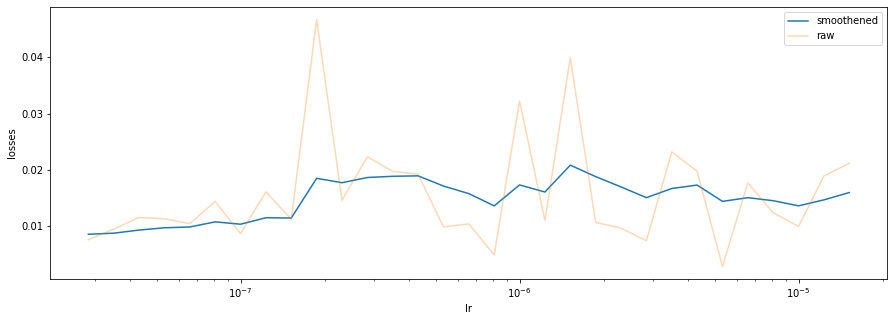

In [0]:
lrf(trainer_dn)

In [0]:
for pg in trainer_dn.optimizer.param_groups:
    # pg['weight_decay'] = 1e-4
    # pg['weight_decay'] = 1e-5
    pg['weight_decay'] = 1e-3

In [0]:
trainer_dn.configure_optimizer(trainer_dn, slice(1e-5, 5e-5), unlock=25)

In [0]:
fit_ex(trainer_dn, epochs=20,lr_slice=slice(1e-5,5e-5)) 

 [1/10] - train :: loss: 0.7949 | accuracy: 0.7816 
          valid :: loss: 0.6335 | accuracy: 0.8877 
          epoch time: 02 m 18 s 888 ms


 [2/10] - train :: loss: 0.5812 | accuracy: 0.8139 
          valid :: loss: 0.4492 | accuracy: 0.9096 
          epoch time: 02 m 18 s 505 ms


 [3/10] - train :: loss: 0.4523 | accuracy: 0.8510 
          valid :: loss: 0.4540 | accuracy: 0.9123 
          epoch time: 02 m 18 s 457 ms


 [4/10] - train :: loss: 0.4375 | accuracy: 0.8633 
          valid :: loss: 0.4892 | accuracy: 0.9205 
          epoch time: 02 m 18 s 823 ms


 [5/10] - train :: loss: 0.3757 | accuracy: 0.8757 
          valid :: loss: 0.4629 | accuracy: 0.9452 
          epoch time: 02 m 19 s 217 ms


 [6/10] - train :: loss: 0.3873 | accuracy: 0.8764 
          valid :: loss: 0.4492 | accuracy: 0.9178 
          epoch time: 02 m 18 s 418 ms


 [7/10] - train :: loss: 0.3044 | accuracy: 0.8846 
          valid :: loss: 0.4202 | accuracy: 0.9397 
          epoch time: 02 m 18 s 182 ms


 [8/10] - train :: loss: 0.3100 | accuracy: 0.8922 
          valid :: loss: 0.3955 | accuracy: 0.9370 
          epoch time: 02 m 18 s 335 ms


 [9/10] - train :: loss: 0.2505 | accuracy: 0.9162 
          valid :: loss: 0.4066 | accuracy: 0.9479 
          epoch time: 02 m 18 s 870 ms


[10/10] - train :: loss: 0.2639 | accuracy: 0.9080 
          valid :: loss: 0.4193 | accuracy: 0.9370 
          epoch time: 02 m 18 s 639 ms

-------
total time: 23 m 07 s 081 ms
best score: 0.9479


In [0]:
print(windx)
hard_sample_swap(trainer_dn, windx)

[109 117]


In [0]:
"""
If valid crosses train : hard sample switch, train
at this point validation score means nothing, but the model
should become better, kinda wingin it at this point.
"""
# fit_ex(trainer_dn, epochs=10,lr_slice=slice(10,1),load_best=False) # 0.9479
# trainer_dn.fit(3, load_best=False)
fit_oc(trainer_dn,max_lr=1e-6,epochs=2, load_best=False)

[1/2] - train :: loss: 0.1287 | accuracy: 0.9643 
        valid :: loss: 0.0808 | accuracy: 0.9863 
        epoch time: 01 m 23 s 664 ms


[2/2] - train :: loss: 0.1249 | accuracy: 0.9581 
        valid :: loss: 0.0746 | accuracy: 0.9918 
        epoch time: 01 m 22 s 947 ms

-----
total time: 02 m 47 s 273 ms
best score: 1.0000


In [0]:
trainer_dn.test() # test :: loss: 0.1233 | accuracy: 0.9699 
trainer_dn.load("dn201_state")
trainer_dn.save("dn201_state", override=False)

In [0]:
trainer_dn.configure_optimizer(trainer_dn, slice(1e-8, 1e-5), unlock=True)

In [0]:
fit_oc(trainer_dn,max_lr=1e-5,epochs=8, load_best=False)

In [0]:
# trainer_dn.test()
trainer_dn.load("dn201_state_ld")
# trainer_dn.save("dn201_state_ld", override=False)

test :: loss: 0.0227 | accuracy: 1.0000 

-----
total time: 17 s 966 ms


In [0]:
windx = np.array([109, 117])


accuracy  :: 0.9863
roc-auc   :: 0.9997
precision :: healthy: 1.0000 multiple_diseases: 0.8889 rust: 0.9840 scab: 0.9916 
recall    :: healthy: 0.9717 multiple_diseases: 1.0000 rust: 1.0000 scab: 0.9833 
f1        :: healthy: 0.9856 multiple_diseases: 0.9412 rust: 0.9919 scab: 0.9874 

['healthy', 'multiple_diseases', 'rust', 'scab']



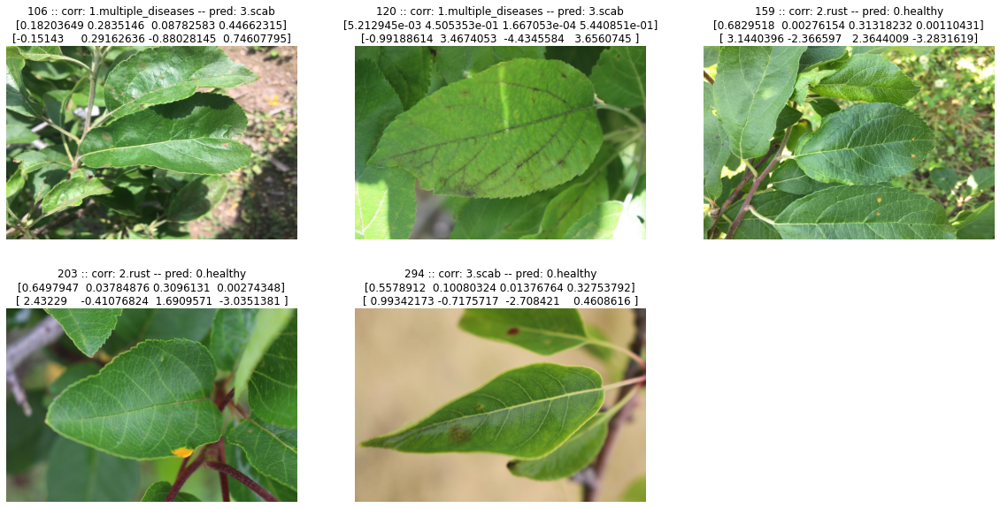

In [0]:
windx = plt_incorrect(trainer_dn.model, trainer_dn.valid_dl)

## Resnet 101

In [0]:
rn101 = build_model("rn101", pretrained=True)

# optimizer lr gets overriden when fit_oc is called
optimizer_rn = optim.Adam(rn101.parameters(), lr=8e-4, weight_decay=1e-5)

fdict_rn = {
    "model": rn101,
    "optimizer":optimizer_rn,
    **get_fdict("rn101")
}
trainer_rn = FitLoop(**fdict_rn)

Downloading: "https://download.pytorch.org/models/resnet101-5d3b4d8f.pth" to /root/.cache/torch/checkpoints/resnet101-5d3b4d8f.pth


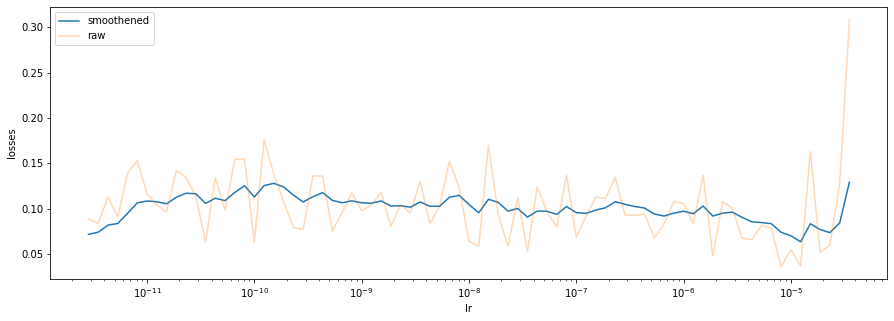

In [0]:
lrf(trainer_rn, lr=slice(1e-12,1e-3))

In [0]:
# trainer_rn.configure_optimizer(trainer_rn, lr=slice(1e-9,1e-5), unlock=True)
# trainer_rn.configure_optimizer(trainer_rn, lr=slice(1e-8,1e-5), unlock=True)
# trainer_rn.configure_optimizer(trainer_rn, lr=slice(1e-7, 1e-5), unlock=True)
# trainer_rn.configure_optimizer(trainer_rn, lr=1e-10, unlock=4)

In [0]:
for p in trainer_rn.optimizer.param_groups:
    p["weight_decay"] = 0

In [0]:
# fit_ex(trainer_rn, epochs=4, lr_slice=slice(1e-5,1e-4), load_best=False) # 0.9014 
# fit_oc(trainer_rn, epochs=5, max_lr=1e-5) # 0.9479
# fit_oc(trainer_rn, epochs=2, max_lr=5e-5, pct_start=0.3) # 0.9534
# trainer_rn.fit(epochs=3, load_best=False) # 0.9616
# trainer_rn.fit(epochs=4, load_best=False) # hss 0.9699 | 0.9726
# fit_oc(trainer_rn, epochs=10, max_lr=8e-6, pct_start=0.4, load_best=False) 
trainer_rn.fit(epochs=10, continue_loop=1, load_best=False)

In [0]:
# trainer_rn.save("rn101_state_ss", override=True)
trainer_rn.test()

test :: loss: 0.2249 | accuracy: 0.9616 

-----
total time: 14 s 540 ms


In [0]:
trainer_rn.load("rn101_state")
# windx = np.array([57, 67, 115, 117, 143, 168, 236])
# hard_sample_swap(trainer_rn, windx)
trainer_rn.test()

test :: loss: 0.4145 | accuracy: 0.9507 

-----
total time: 23 s 063 ms


In [0]:
fit_oc(trainer_rn, max_lr=10e-5, epochs=8)

[1/8] - train :: loss: 0.3162 | accuracy: 0.9215 
        valid :: loss: 0.3901 | accuracy: 0.9507 
        epoch time: 39 s 576 ms


[2/8] - train :: loss: 0.3470 | accuracy: 0.9171 
        valid :: loss: 0.3250 | accuracy: 0.9534 
        epoch time: 39 s 701 ms


[3/8] - train :: loss: 0.3431 | accuracy: 0.9072 
        valid :: loss: 0.2542 | accuracy: 0.9479 
        epoch time: 40 s 086 ms


[4/8] - train :: loss: 0.2741 | accuracy: 0.9198 
        valid :: loss: 0.1764 | accuracy: 0.9753 
        epoch time: 40 s 289 ms


[5/8] - train :: loss: 0.2770 | accuracy: 0.9132 
        valid :: loss: 0.1926 | accuracy: 0.9753 
        epoch time: 40 s 408 ms


[6/8] - train :: loss: 0.2477 | accuracy: 0.9198 
        valid :: loss: 0.1676 | accuracy: 0.9781 
        epoch time: 40 s 354 ms


[7/8] - train :: loss: 0.2250 | accuracy: 0.9341 
        valid :: loss: 0.1720 | accuracy: 0.9753 
        epoch time: 39 s 917 ms


[8/8] - train :: loss: 0.2104 | accuracy: 0.9297 
        valid :: loss: 0.1699 | accuracy: 0.9753 
        epoch time: 39 s 744 ms

-----
total time: 05 m 20 s 858 ms
best score: 0.9781


In [0]:
trainer_rn.save("rn101_state_ld")
trainer_rn.model.cpu();


accuracy  :: 0.9671
roc-auc   :: 0.9879
precision :: healthy: 0.9709 multiple_diseases: 0.7778 rust: 0.9680 scab: 0.9916 
recall    :: healthy: 0.9804 multiple_diseases: 0.7368 rust: 0.9837 scab: 0.9752 
f1        :: healthy: 0.9756 multiple_diseases: 0.7568 rust: 0.9758 scab: 0.9833 

['healthy', 'multiple_diseases', 'rust', 'scab']



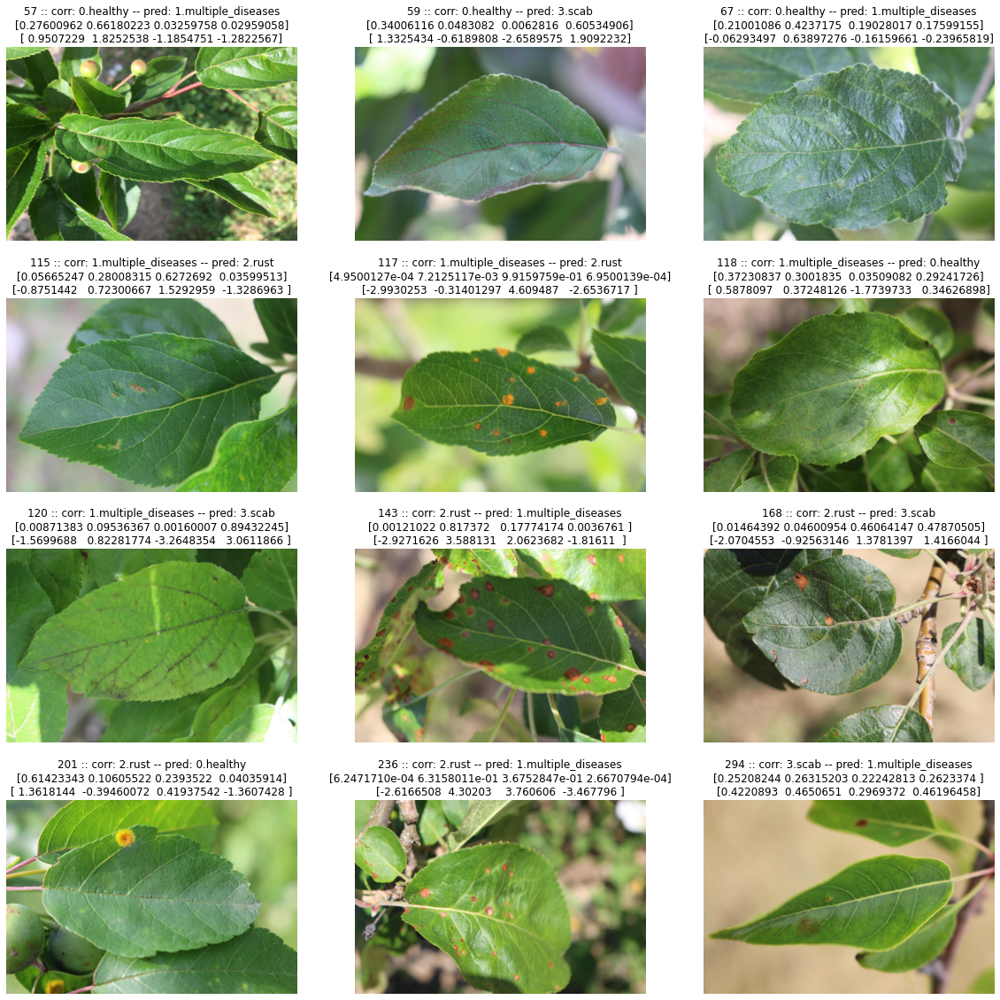

In [0]:
# accuracy  :: 0.9671
# roc-auc   :: 0.9879
# precision :: healthy: 0.9709 multiple_diseases: 0.7778 rust: 0.9680 scab: 0.9916 
# recall    :: healthy: 0.9804 multiple_diseases: 0.7368 rust: 0.9837 scab: 0.9752 
# f1        :: healthy: 0.9756 multiple_diseases: 0.7568 rust: 0.9758 scab: 0.9833

windx = plt_incorrect(trainer_rn.model, trainer_rn.valid_dl)

## ResNext 50

In [0]:
rnx50 = build_model("rnx50", pretrained=True)

# optimizer lr gets overriden when fit_oc is called
optimizer_rx = optim.Adam(rnx50.parameters(), lr=8e-4, weight_decay=1e-5)

fdict_rx = {
    "model": rnx50,
    "optimizer":optimizer_rx,
    **get_fdict("rnx50")
}
trainer_rx = FitLoop(**fdict_rx)

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-7cdf4587.pth" to /root/.cache/torch/checkpoints/resnext50_32x4d-7cdf4587.pth


In [0]:
# trainer_rx.configure_optimizer(trainer_rx, lr=1e-4, unlock=4)
trainer_rx.configure_optimizer(trainer_rx, lr=slice(1e-8, 1e-5), unlock=True)

In [0]:
# fit_ex(trainer_rx, epochs=6, lr_slice=slice(1e-6,1e-5))
fit_ex(trainer_rx, epochs=10, lr_slice=slice(1e-5,1e-6))

In [0]:
"""
train :: loss: 0.1613 | accuracy: 0.9423 
valid :: loss: 0.2764 | accuracy: 0.9699
"""
fit_oc(trainer_rx, epochs=4, max_lr=1e-5, load_best=True)

[1/4] - train :: loss: 0.1450 | accuracy: 0.9499 
        valid :: loss: 0.2783 | accuracy: 0.9726 
        epoch time: 41 s 830 ms


[2/4] - train :: loss: 0.1402 | accuracy: 0.9505 
        valid :: loss: 0.2746 | accuracy: 0.9699 
        epoch time: 41 s 382 ms


[3/4] - train :: loss: 0.1507 | accuracy: 0.9409 
        valid :: loss: 0.2891 | accuracy: 0.9726 
        epoch time: 42 s 367 ms


[4/4] - train :: loss: 0.1520 | accuracy: 0.9512 
        valid :: loss: 0.2752 | accuracy: 0.9616 
        epoch time: 41 s 331 ms

-----
total time: 02 m 47 s 458 ms
best score: 0.9726


In [0]:
# trainer_rx.best_score = 0.9670

In [0]:
"""
Fix the naming
"""
# trainer_rx.save("rx50_state", override=True)
trainer_rx.load("rx50_state")
# trainer_rx.test() # loss: 0.2561 | accuracy: 0.9726 

In [0]:
fit_oc(trainer_rx, max_lr=1e-5, epochs=8)

[1/8] - train :: loss: 0.2005 | accuracy: 0.9577 
        valid :: loss: 0.3012 | accuracy: 0.9616 
        epoch time: 46 s 725 ms


[2/8] - train :: loss: 0.1874 | accuracy: 0.9621 
        valid :: loss: 0.2370 | accuracy: 0.9699 
        epoch time: 46 s 726 ms


[3/8] - train :: loss: 0.1616 | accuracy: 0.9632 
        valid :: loss: 0.1611 | accuracy: 0.9753 
        epoch time: 46 s 876 ms


[4/8] - train :: loss: 0.1448 | accuracy: 0.9594 
        valid :: loss: 0.1525 | accuracy: 0.9808 
        epoch time: 47 s 218 ms


[5/8] - train :: loss: 0.1628 | accuracy: 0.9577 
        valid :: loss: 0.1481 | accuracy: 0.9836 
        epoch time: 47 s 038 ms


[6/8] - train :: loss: 0.1105 | accuracy: 0.9687 
        valid :: loss: 0.1306 | accuracy: 0.9918 
        epoch time: 47 s 496 ms


[7/8] - train :: loss: 0.1141 | accuracy: 0.9616 
        valid :: loss: 0.1264 | accuracy: 0.9836 
        epoch time: 46 s 835 ms


[8/8] - train :: loss: 0.1475 | accuracy: 0.9539 
        valid :: loss: 0.1265 | accuracy: 0.9836 
        epoch time: 46 s 971 ms

-----
total time: 06 m 19 s 908 ms
best score: 0.9918


In [0]:
trainer_rx.save("rx50_state_ld")
trainer_rx.model.cpu()

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
        (bn2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(128, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0

In [0]:
windx = np.array([67, 80, 109, 114, 143, 159, 314])
hard_sample_swap(trainer_rx, windx)
# no_swap : loss: 0.2665 | accuracy: 0.9671 (after hss)
# ye_swap : loss: 0.2745 | accuracy: 0.9781 

trainer_rx.test()

test :: loss: 0.2796 | accuracy: 0.9616 

-----
total time: 15 s 160 ms



accuracy  :: 0.9726
roc-auc   :: 0.9787
precision :: healthy: 0.9806 multiple_diseases: 0.6667 rust: 0.9840 scab: 1.0000 
recall    :: healthy: 0.9806 multiple_diseases: 0.9231 rust: 0.9609 scab: 0.9835 
f1        :: healthy: 0.9806 multiple_diseases: 0.7742 rust: 0.9723 scab: 0.9917 

['healthy', 'multiple_diseases', 'rust', 'scab']



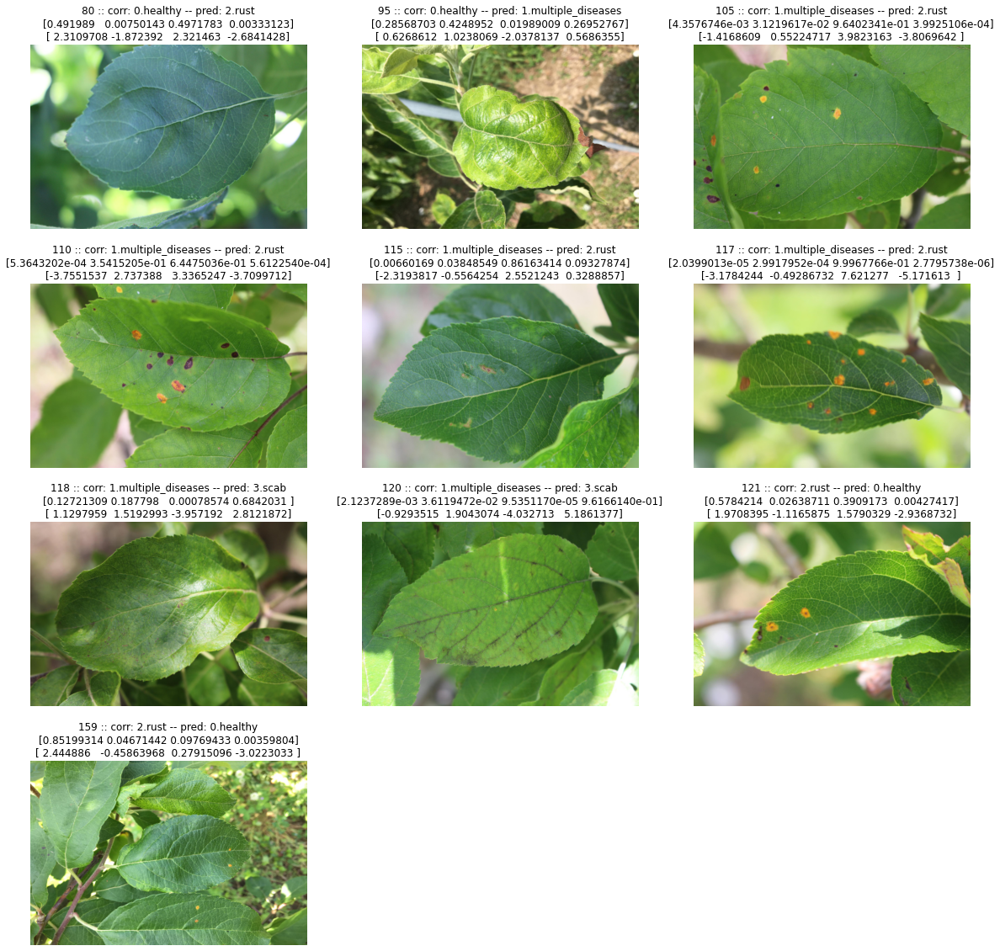

In [0]:
# accuracy  :: 0.9726
# roc-auc   :: 0.9787
# precision :: healthy: 0.9806 multiple_diseases: 0.6667 rust: 0.9840 scab: 1.0000 
# recall    :: healthy: 0.9806 multiple_diseases: 0.9231 rust: 0.9609 scab: 0.9835 
# f1        :: healthy: 0.9806 multiple_diseases: 0.7742 rust: 0.9723 scab: 0.9917 

windx = plt_incorrect(trainer_rx.model, trainer_rx.valid_dl)

## EfficientNet B4

In [0]:
effn4 = build_model("effn4", pretrained=True)


# optimizer lr gets overriden when fit_oc is called
optimizer_ef = optim.Adam(effn4.parameters(), lr=8e-4, weight_decay=0)

fdict_ef = {
    "model": effn4,
    "optimizer":optimizer_ef,
    **get_fdict("effn4")
}

trainer_ef = FitLoop(**fdict_ef)

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b4-6ed6700e.pth" to /root/.cache/torch/checkpoints/efficientnet-b4-6ed6700e.pth



Loaded pretrained weights for efficientnet-b4


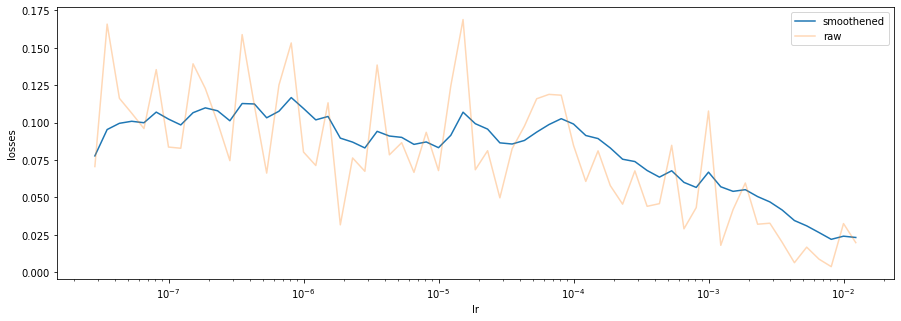

In [0]:
lrf(trainer_ef)

In [0]:
trainer_ef.configure_optimizer(trainer_ef, lr=slice(1e-6,1e-3), unlock=True)

In [0]:
# train :: loss: 0.2123 | accuracy: 0.9293 
# valid :: loss: 0.6758 | accuracy: 0.9507

fit_oc(trainer_ef, max_lr=1e-4, epochs=4, load_best=False) # 

[1/4] - train :: loss: 0.2702 | accuracy: 0.9245 
        valid :: loss: 0.1527 | accuracy: 0.9726 
        epoch time: 35 s 957 ms


[2/4] - train :: loss: 0.2046 | accuracy: 0.9313 
        valid :: loss: 0.1519 | accuracy: 0.9753 
        epoch time: 36 s 073 ms


[3/4] - train :: loss: 0.2408 | accuracy: 0.9272 
        valid :: loss: 0.1477 | accuracy: 0.9726 
        epoch time: 35 s 528 ms


[4/4] - train :: loss: 0.2624 | accuracy: 0.9299 
        valid :: loss: 0.1464 | accuracy: 0.9753 
        epoch time: 36 s 177 ms

-----
total time: 02 m 24 s 119 ms
best score: 0.9753


In [0]:
# trainer_ef.M.clear()
# trainer_ef.save("effn4_state", override=False)
trainer_ef.load("effn4_state")

# test :: loss: 0.2756 | accuracy: 0.9616 
# trainer_ef.test()

In [0]:
fit_oc(trainer_ef, max_lr=1e-3,epochs=8)

[1/8] - train :: loss: 0.2899 | accuracy: 0.9204 
        valid :: loss: 0.2611 | accuracy: 0.9616 
        epoch time: 44 s 245 ms


[2/8] - train :: loss: 0.2495 | accuracy: 0.9204 
        valid :: loss: 0.2456 | accuracy: 0.9671 
        epoch time: 43 s 978 ms


[3/8] - train :: loss: 0.2343 | accuracy: 0.9347 
        valid :: loss: 0.1976 | accuracy: 0.9699 
        epoch time: 43 s 932 ms


[4/8] - train :: loss: 0.2625 | accuracy: 0.9242 
        valid :: loss: 0.1718 | accuracy: 0.9726 
        epoch time: 44 s 068 ms


[5/8] - train :: loss: 0.2286 | accuracy: 0.9193 
        valid :: loss: 0.1642 | accuracy: 0.9753 
        epoch time: 44 s 344 ms


[6/8] - train :: loss: 0.2229 | accuracy: 0.9303 
        valid :: loss: 0.1585 | accuracy: 0.9753 
        epoch time: 44 s 324 ms


[7/8] - train :: loss: 0.2291 | accuracy: 0.9292 
        valid :: loss: 0.1432 | accuracy: 0.9781 
        epoch time: 44 s 101 ms


[8/8] - train :: loss: 0.2301 | accuracy: 0.9253 
        valid :: loss: 0.1479 | accuracy: 0.9753 
        epoch time: 44 s 383 ms

-----
total time: 05 m 57 s 387 ms
best score: 0.9781


In [0]:
trainer_ef.save("effn4_state_ld")
trainer_ef.model.cpu();

In [0]:
windx = np.array([75, 108, 109, 110, 114, 115, 117, 143, 168, 236])
# loss: 0.1602 | accuracy: 0.9753  pst
# loss: 0.2688 | accuracy: 0.9616 pre
hard_sample_swap(trainer_ef, windx)
trainer_ef.test()

test :: loss: 0.2690 | accuracy: 0.9616 

-----
total time: 17 s 687 ms



accuracy  :: 0.9534
roc-auc   :: 0.9649
precision :: healthy: 0.9903 multiple_diseases: 0.4444 rust: 0.9600 scab: 0.9916 
recall    :: healthy: 0.9714 multiple_diseases: 0.8000 rust: 0.9600 scab: 0.9440 
f1        :: healthy: 0.9808 multiple_diseases: 0.5714 rust: 0.9600 scab: 0.9672 

['healthy', 'multiple_diseases', 'rust', 'scab']



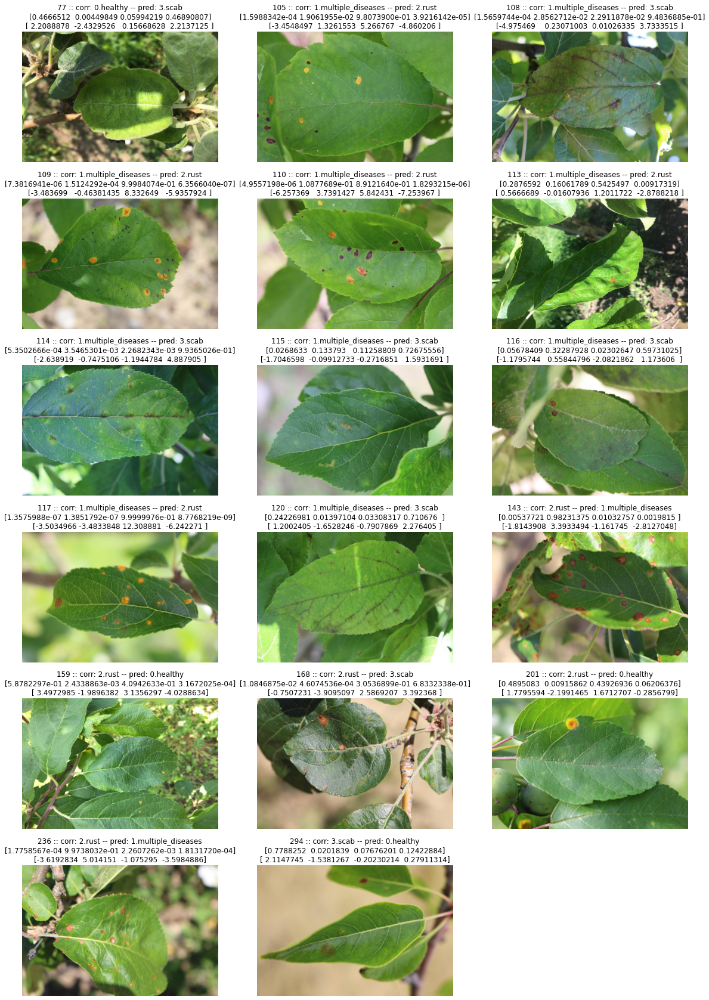

In [0]:
windx = plt_incorrect(trainer_ef.model, trainer_ef.valid_dl)

pred: 1 - multiple_diseases
corr: 2 - rust
mean logts:  -2.3457   3.6959  -0.6392  -3.7550
mean probs:   0.0023   0.9842   0.0129   0.0006


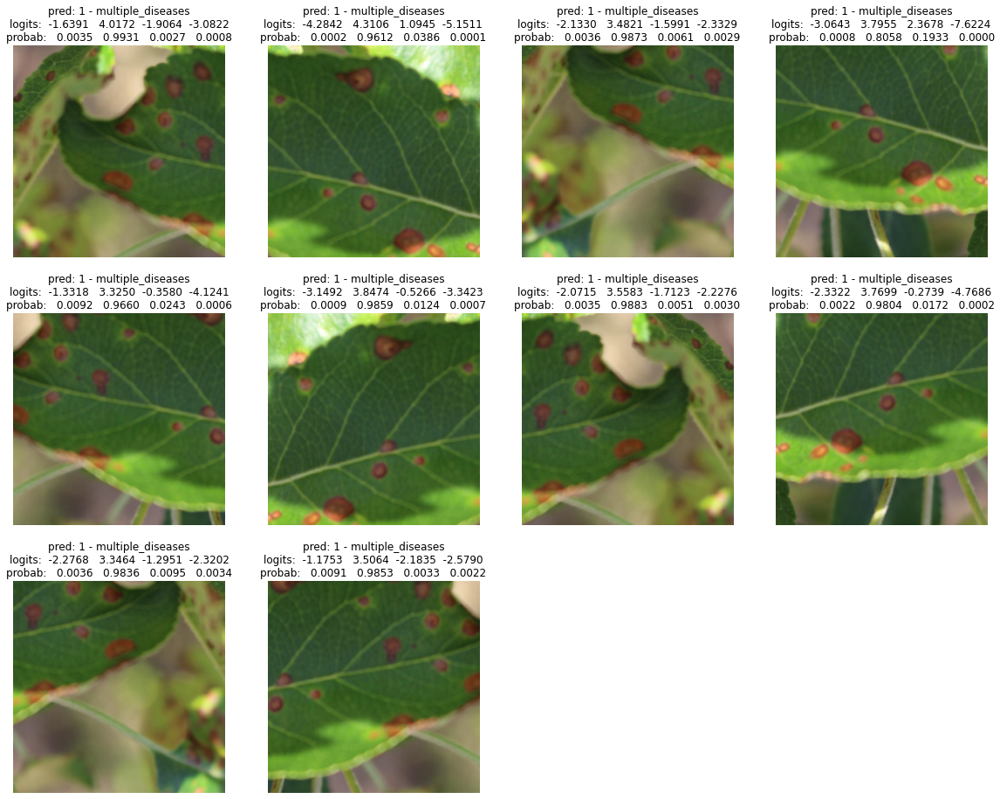

In [0]:
inspect_prediction(trainer_ef.model, 143)

# Aggregator Model

## Preparing data

In [30]:
"""
Create train set of all the tencrops, from all the models
so for 1500 samples the input would be 
10 * batchsize * 4, 4 for the number of models
output will be 4 dim logits which when softmaxed will
give prediction.

Create similar validation set and save it
"""
model_list = [trainer_dn.model, trainer_rn.model, trainer_rx.model, trainer_ef.model]

'\nCreate train set of all the tencrops, from all the models\nso for 1500 samples the input would be \n10 * batchsize * 4, 4 for the number of models\noutput will be 4 dim logits which when softmaxed will\ngive prediction.\n\nCreate similar validation set and save it\n'

In [0]:
def get_logits(ds, model):
    logits = []
    model.eval().to(device)
    for X,_ in tqdm(ds):
        with torch.no_grad():
            logits.append(model(X.to(device)))
    model.cpu()
    return torch.stack(logits).cpu()

def get_target_logits(ds, model_list):
    try:
        targets = torch.tensor(ds.targets)
    except:
        targets = ds.targets
    logits = []
    for m in model_list:
        logits.append(get_logits(ds, m))
    return torch.stack(logits, axis=1), targets

def save_meta_data():
    # training data
    meta_train_data = get_target_logits(ds_train, model_list)
    torch.save({
        "X":meta_train_data[0],
        "y":meta_train_data[1]
    },g_state_path/"meta_train_data.pt")
    
    # validation data
    meta_valid_data = get_target_logits(ds_valid, model_list)
    torch.save({
        "X":meta_valid_data[0],
        "y":meta_valid_data[1]
    },g_state_path/"meta_valid_data.pt")


In [0]:
save_meta_data()

meta_test_data = get_target_logits(ds_test, model_list)
torch.save({
    "X":meta_test_data[0],
    "y":meta_test_data[1]
}, g_state_path/"meta_test_data.pt")


## Meta Model

In [0]:
from torch.utils.data import TensorDataset

def get_mds(path):
    mdata = torch.load(path)
    sz = mdata["X"].shape[0]
    return TensorDataset(mdata["X"].reshape(sz,-1), mdata["y"])

In [32]:
ds_mtrain = get_mds(g_state_path/"meta_train_data.pt")
ds_mvalid = get_mds(g_state_path/"meta_valid_data.pt")

dl_mtrain = DataLoader(ds_mtrain, batch_size=256, shuffle=True)
dl_mvalid = DataLoader(ds_mvalid, batch_size=256, shuffle=True)

len(ds_mtrain), len(ds_mvalid), len(dl_mtrain), len(dl_mvalid)

(1456, 365, 6, 2)

In [0]:
def common_step(state):
    X,y = state.batch
    y_ = state.model(X)
    loss = state.loss_function(y_,y)
    return {
        "corr": (y_.argmax(dim=1) == y).sum().detach().cpu().float(),
        "loss": loss * state.batch_size
    }, loss

def train_step(state):
    rdict, loss = common_step(state)
    loss.backward()
    state.optimizer.step()
    if state.lr_scheduler is not None:
        state.lr_scheduelr.step()
    del loss
    return rdict

def valid_step(state):
    rdict, loss = common_step(state)
    del loss
    return rdict

def common_epoch_end(state):
    return {
        "loss":state["loss"].sum()/state.size,
        "accu":state["corr"].sum()/state.size
    }

In [0]:
model = nn.Sequential(
    nn.Linear(10 * 4 * 4, 512),
    nn.ReLU(),
    nn.Linear(512,256),
    nn.Dropout(p=0.5),
    nn.ReLU(),
    nn.Dropout(p=0.5),
    nn.Linear(256,4),
)


fdict = {
    "train_step":train_step,
    "valid_step":valid_step,
    "train_epoch_end":common_epoch_end,
    "valid_epoch_end":common_epoch_end,
    "train_dl": dl_mtrain,
    "valid_dl": dl_mvalid,
    "criteria":"accu",
    "loss_function": nn.CrossEntropyLoss(weight=torch.from_numpy(weights).to(device).float()),
    "model":model,
    "best_model_name":"meta_model",
    "save_path":g_state_path,
    "optimizer":optim.Adam(model.parameters())
}
trainer = FitLoop(**fdict)

In [0]:
trainer.configure_optimizer(trainer, lr=3e-3)

In [36]:
trainer.fit(epochs=6) # 0.9781

[1/6] - train :: loss: 0.3493 | accu: 0.8462 
        valid :: loss: 0.1398 | accu: 0.9945 
        epoch time: 00 s 320 ms


[2/6] - train :: loss: 0.0031 | accu: 0.9986 
        valid :: loss: 0.2705 | accu: 0.9918 
        epoch time: 00 s 102 ms


[3/6] - train :: loss: 0.0760 | accu: 0.9979 
        valid :: loss: 0.2069 | accu: 0.9890 
        epoch time: 00 s 113 ms


[4/6] - train :: loss: 0.0352 | accu: 0.9945 
        valid :: loss: 0.3369 | accu: 0.9918 
        epoch time: 00 s 109 ms


[5/6] - train :: loss: 0.0142 | accu: 0.9979 
        valid :: loss: 0.5146 | accu: 0.9945 
        epoch time: 00 s 125 ms


[6/6] - train :: loss: 0.0131 | accu: 0.9979 
        valid :: loss: 0.6215 | accu: 0.9945 
        epoch time: 00 s 110 ms

-----
total time: 01 s 548 ms
best score: 0.9945


In [0]:
trainer.save("meta_model_state", override=False)

In [0]:
def get_logits_targets(model, ds):
    logits = []
    targets = []
    model.eval().to(device)
    for X,y in tqdm(ds):
        targets.append(y)
        with torch.no_grad():
            y_ = model(X.to(device)).detach().cpu()
            logits.append(y_.cpu())
    return torch.stack(logits).squeeze(), targets

In [38]:
# Train Data
logits, targets = get_logits_targets(trainer.model, ds_mtrain)
print_scores(get_scores(logits, torch.tensor(targets), all=True))


accuracy  :: 0.9993
roc-auc   :: 0.9999
precision :: healthy: 1.0000 multiple_diseases: 1.0000 rust: 1.0000 scab: 0.9979 
recall    :: healthy: 1.0000 multiple_diseases: 0.9865 rust: 1.0000 scab: 1.0000 
f1        :: healthy: 1.0000 multiple_diseases: 0.9932 rust: 1.0000 scab: 0.9989 


In [39]:
# Valid Data
logits, targets = get_logits_targets(trainer.model, ds_mvalid)
print_scores(get_scores(logits, torch.tensor(targets), all=True))


accuracy  :: 0.9945
roc-auc   :: 0.9967
precision :: healthy: 1.0000 multiple_diseases: 0.9444 rust: 0.9920 scab: 1.0000 
recall    :: healthy: 1.0000 multiple_diseases: 1.0000 rust: 0.9920 scab: 0.9917 
f1        :: healthy: 1.0000 multiple_diseases: 0.9714 rust: 0.9920 scab: 0.9958 


# Generating Submission from Actual Test Data

In [0]:
def test(ds, model):
    probs = []
    names = []
    model.eval()
    for X, name in tqdm(ds):
        with torch.no_grad():
            y_ = model(X.to(device))
        y_ = y_.mean(dim=0)
        pr = F.softmax(y_,dim=0).detach().cpu()
        probs.append(pr)
        names.append(name)
    return torch.stack(probs).numpy(), np.array(names)

def smoothen_labels(probs, alpha=0.01):
    return (1 - alpha) * probs + alpha/4

def submission(name, trainer):
    probs, names = test(ds_test, trainer.model)
    probs_sm = smoothen_labels(probs)
    df = pd.DataFrame(np.append(names.reshape(-1,1),probs_sm,axis=1),columns=['image_id',*class_names])
    df.to_csv(f"./submission_{name}.csv", index=False)
    return probs, names

In [0]:
probs_dn, names = submission("dn", trainer_dn) # 0.950

In [0]:
probs_rn, names = submission("rn", trainer_rn) # 0.931

In [0]:
probs_rx, names = submission("rx", trainer_rx) # 0.945

In [0]:
probs_ef, names = submission("ef", trainer_ef)

### Generate Test Predictions from meta test

In [0]:
class MetaTestDS(Dataset):
    def __init__(self, path=g_state_path/"meta_test_data.pt"):
        data = torch.load(path)
        self.targets = data["y"]
        self.tensors = data["X"]
    
    def __getitem__(self, idx):
        x = self.tensors[idx]
        y = self.targets[idx]
        return x.reshape(1,-1),y

    def __len__(self):
        return len(self.targets)

def meta_submission(logits, names):
    probs = F.softmax(logits, dim=1).numpy()
    probs = smoothen_labels(probs)
    names = np.array(names)
    df = pd.DataFrame(np.append(names.reshape(-1,1),probs,axis=1),columns=['image_id',*class_names])
    df.to_csv(f"./submission_final.csv", index=False)
    return df

In [45]:
ds_mtest = MetaTestDS()
logits, names = get_logits_targets(model, ds_mtest)
meta_submission(logits, names)

,image_id,healthy,multiple_diseases,rust,scab
0,Test_870,0.0025,0.9925,0.0025,0.0025
1,Test_1166,0.69907874,0.018158054,0.0025000211,0.2802632
2,Test_386,0.0025000097,0.588103,0.40688887,0.0025081714
3,Test_337,0.98850995,0.0025,0.0025,0.006490015
4,Test_494,0.0025,0.0025,0.9925,0.0025
...,...,...,...,...,...
1816,Test_1159,0.0025,0.0025,0.9925,0.0025
1817,Test_1288,0.9925,0.0025,0.0025,0.0025
1818,Test_755,0.0025,0.0025,0.0025,0.9925
1819,Test_640,0.0025,0.0025,0.0025,0.9925


# Post
## Conclusion
Best score wash a measly 0.953 after ensembling and before ensembling 0.950, okay for a first attempt at a serious FGVC..?  
**Some reasons why the setup underperformed:**
- Test time Ten Crop, since classification can depend on very small percent of pixels example a tiny yellow spot can be the difference between 0.99 Healthy and 0.99 Rust, the TenCrop fails cause if only 4/10 have the yellow spot the prediction is a less confident Healthy instead of Rust, this may have been the biggest folly.
- Random Crops during train, similar to the ten crop error, the model could be picking up on wrong patterns when a crop has no spot in it but the label says Rust.

## Improvements/Should have trieds
- Use some method to highlight the features that result in the classification to learn the mapping better example the brownish splotches for Scab or the yellow Spots for Rust. Perhaps CLAHE would have helped with this.
- Training a model that specializes in Multiple Diseases.
- Different kinds of ensemembling, the current method consisted of training a meta model that learns each models weightage and gives as output 4 logits for and input of 160 ie 10 crops from 4 models each having 4 logits for each of the class, this may not have performed as well as envisioned.
- Similar training and testing/validation strategies, the used training and testing/validation were different from each other, Random Crops for one and TenCrops for the other.
- Using a larger crop of the leaf to train and make predictions so that small important portions such as a single spot aren't missed.
- Detecting the leaf cropping it out and then testing on that, this would have resulted in a much better accuracy but involves training a network for leaf detection, but since Adaptive Pooling layers were used differently sized images of leaves may have worked out well.
- Progressive resizing while training and using larger sized test images.
- Pseudo labelling, using high confidence images from the test dataset to train, (although this may deepen wrong patterns into the model, it's still something that should've been tried).

## Observations
- Overfitting a model isn't as easy, the training bottoms out after a certain point after which the training loss and accuracy just stochastically oscillate.   
This is becuase the model isn't seeing the same training data every time due to the randomly applied augmentations everytime a sample is drawn.
- Imbalanced datasets are difficult to deal with, for all models the Multiple Diseases class had consistently lower F1 scores perhaps using augmentation to increase it's numbers may have helped.
- Hard Sample Learning works (kinda), after swapping for the hard samples in the validation that consistently refused to be correctly classified the slight imporvements in the test scores were seen, although this obliterates the demarcation between the train and the validation dataset, validation makes little sense after this, but this may have been because of the swapping there would be a better way of going about training with just the hard samples.
- TenCrop and RandomCrop may have been the undoing of this attempt.